# Netzwerk-Analyse<div class="tocSkip">

### Hilfsfunktionen und Einstellungen <div class="tocSkip">

**Bitte ausführen!!**

In [13]:
%run "../lib/settings.py"

%reload_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

# to print output of all statements and not just the last
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# path to import blueprints packages
sys.path.append('../lib')

## Daten vorbereiten


### Daten einlesen


Hier werden die Daten aus der bisherigen Datenbank geladen

In [2]:
database = '../resources/bt_reden_final.sqlite'

sql = """
SELECT speech_id, speaker, 
  affiliation, text, session_id, session_date, 
  entities, clean_text
FROM bt_reden_prepared
"""

con = sqlite3.connect(database)
df = pd.read_sql_query(sql, con, parse_dates=['created_at'])
con.close()

In [3]:
df

,speech_id,speaker,affiliation,text,session_id,session_date,entities,clean_text
0,ID194300100,Olaf Scholz,Bundesminister BMF,Herr Präsident! Meine Damen und Herren! Griechenland wird das dritte Hilfsprogramm planmäßig am 20. August 2018 beenden. Damit kann Griechenland die Rettungsschirme nach acht Jahren verlassen und ...,43,2018-06-29,Griechenland/LOC Griechenland/LOC Europäischen_Union/ORG Euro-Gruppe/ORG Portugal/LOC Irland/LOC Europa/LOC Europa/LOC Europäischen_Union/ORG Europa/LOC Euro-Gruppe/ORG Deutsche_Bundestag/ORG Grie...,Griechenland Hilfsprogramm planmäßig 20. August 2018 beenden Griechenland Rettungsschirme verlassen Chance Bein stehen Nachricht Nachricht anschließen Europäische Union Euro-Gruppe gemeinsam gelin...
1,ID194300200,Peter Boehringer,AfD,Herr Präsident! Liebe Kolleginnen! Liebe Kollegen! In der heutigen Vorlage steht auf 480 Seiten eigentlich nur eines: Griechenland bekommt eine weitere Finanzspritze in Milliardenhöhe. Konkret: De...,43,2018-06-29,Griechenland/LOC Milliardenhöhe/ORG Deutschland/LOC Griechenland/LOC Bundestag/ORG Griechenland/LOC EZB/ORG Zinserlöse/PER Deutschland/LOC Bund/LOC Griechenland-Rettung/LOC Bundestag/ORG Griechenl...,heutig Vorlage stehen 480 Seite eigentlich Griechenland bekommen Finanzspritze Milliardenhöhe Konkret Tilgungsbeginn fällige EFSF-Kredite 2030 liegen Deutschland verzichten hoch Zinserträge allein...
2,ID194300300,Eckhardt Rehberg,CDU/CSU,"Herr Präsident! Liebe Kolleginnen und Kollegen! Wenn ich manche Rede zu Griechenland in den letzten acht Jahren Revue passieren lasse, dann fallen mir auch viele Aussagen zu Irland, Portugal, Span...",43,2018-06-29,Griechenland/LOC Irland/LOC Portugal/LOC Spanien/LOC Zypern/LOC Euro-Zone/ORG Bundesrepublik_Deutschland/LOC Euro-Zone/ORG Europa/LOC Europa/LOC Deutschland/LOC Scholz/PER Euro-Zone/ORG Griechenla...,Griechenland letzt Revue passieren lassen fallen Aussage Irland Portugal Spanien Zypern Land gut Gewissen bringen zukünftig Kapitalmarkt refinanzieren tun Solidarität leisten fragen Hauptprofiteur...
3,ID194300400,Christian Dürr,FDP,"Herr Präsident! Meine sehr verehrten Kolleginnen und Kollegen! Lieber Kollege Rehberg, Sie sagen: Wir sind im dritten Programm, nicht im vierten. – Das ist ja keine Fernsehsendung hier. In der Nac...",43,2018-06-29,Lieber/PER Rehberg/PER Euro-Gruppe/ORG Schulden­erleichterungen/LOC Rehberg/LOC Griechenland/LOC EZB/ORG IWF/ORG Griechenland/LOC Dürr/PER Hagedorn/PER SPD/ORG Dürr/PER Hagedorn/PER FDP/ORG Deutsc...,Rehberg sagen Programm Fernsehsendung Nacht 21. Juni 22. Juni Finanzminister Euro-Gruppe umfangreich Paket vereinbart Paket Schulden­erleichterungen zusätzlich Bedingung erweitern Überwachung Cash...
4,ID194300500,Fabio De Masi,DIE LINKE,"Herr Präsident! Sehr geehrte Damen und Herren! Griechenland soll nach Jahren der Entbehrungen an den Finanzmarkt zurückkehren. Zeit, sich ehrlich zu machen! 95 Prozent der Griechenland-Kredite in ...",43,2018-06-29,Griechenland/LOC Griechenland-Kredite/LOC Griechenland/LOC Internationalen_Währungsfonds/ORG Spiegel/ORG Euro-Gruppe/ORG Nikea/LOC Krankenschwestern/PER Verlängerungskabeln/PER Griechenland/LOC At...,Griechenland Entbehrung Finanzmarkt zurückkehren 95 Prozent Griechenland-Kredite Höhe 274 Milliarde Euro fließen Schuldendienst deutsch französische Banken griechische Krankenschwestern Rentner Gr...
...,...,...,...,...,...,...,...,...
24642,ID1916710300,Sonja Amalie Steffen,SPD,"Sehr geehrte Frau Präsidentin! Liebe Kolleginnen und Kollegen! Was glauben Sie, was die Leute draußen an den Bildschirmen denken, wenn sie diese Debatte verfolgen? Gerade der letzte Redner vor mir...",167,2020-06-19,Schnieder/PER Philipp_Amthor/PER SPD-Fraktion/ORG Coronapandemie/ORG Abgeordneten/ORG Junge-Unioner/PER Luxusjachten/LOC Straetmanns/PER Union/LOC Steffen/PER Linke/ORG Friedrich_Straetmanns/PER,glauben Leute draußen Bildschirmen denken Debatte verfolgen letzte Redner glauben sorgen schlimm Mensch draußen denken eigentlich Parlament zusätzlich vorweg sage

In [4]:
prepared_columns = ['entities']
for col in prepared_columns:
    df[col] = df[col].str.split()

### Entity-Matching "light"

In dem Dictionary "entities_to_rename" werden Entitäten gesammelt um diese zusammenzufassen. Bei vielen Entitäten handelt es sich, obwohl sie unterschiedlich bennant werden, um die selben Organisationen/Personen/Laction. Und um diese in einem Netzwerk korrekt darzustellen werden sie zu einer Entität zusammengefasst.

In [5]:
entities_to_rename = {
        'Abgeordneten' : 'Abgeordneter',
        'AfD-Fraktion' : 'AfD',
        'AfD.' : 'AfD',
        'Bundestages' : 'Bundestag',
        'Bundesverfassungsgerichts' : 'Bundesverfassungsgericht',
        'Deutsche Bundestag' : 'Deutscher Bundestag',
        'Deutschen Bundestag' : 'Deutscher Bundestag',
        'Deutschen Bundestages' : 'Deutscher Bundestag',
        'Deutschlands' : 'Deutschland',
        'Europas' : 'Europa',
        'Europäische Union' : 'EU',
        'Europäischen Union' : 'EU',
        'EU-Staaten' : 'EU',
        'EU-Mitgliedsstaaten' : 'EU',
        'Europäischen Kommission' : 'EU-Kommission',
        'Europäische Kommission' : 'EU-Kommission',
        'Europäischen Parlament' : 'Europäische Parlament',
        'FDP-Fraktion' : 'FDP',
        'Freie Demokraten' : 'FDP',
        'Freien Demokraten' : 'FDP',
        'Liberalen' : 'FDP',
        'Kommunen' : 'Kommune',
        'Grünen' : 'Grüne',
        'Parlaments' : 'Parlament',
        'Parlamente' : 'Parlament',
        'SPD-Fraktion' : 'SPD',
        'Sozialdemokraten' : 'SPD',
        'Sozialdemokratinnen' : 'SPD',
        'SPD-Bundestagsfraktion' : 'SPD',
        'CDU' : 'CDU/CSU',
        'CSU' : 'CDU/CSU',
        'CSU-Fraktion' : 'CDU/CSU',
        'CSU-Bundestagsfraktion' : 'CDU/CSU',
        'Union' : 'CDU/CSU',
        'Hohen Haus' : 'Hohen Hause',
        'Bundesverfassungsgerichts' : 'Bundesverfassungsgericht',
        'Deutschlands' : 'Deutschland',
        'Europas' : 'Europa',
        'Kitas' : 'Kita',
        'Russlands' : 'Russland',
        'Weltgesundheitsorganisation' : 'WHO',
        'Gewerkschaften' : 'Gewerkschaft',
        'Linken' : 'Linke',
        'Minister Müller' : 'Gerd Müller',
        'Herr Müller' : 'Gerd Müller',
        'Minister Spahn' : 'Jens Spahn',
        'Herr Spahn' : 'Jens Spahn',
        'Herr Seehofer' : 'Horst Seehofer',
        'Herrn Seehofer'  :'Horst Seehofer',
        
    }

Mit dieser Funktionen werden alle Entitäten sauber dargestellt.

In [6]:
def extract_entities_clear(entities):
    entities_clear = []
    for e in entities:
        e = e.split('/')
        if len(e) == 2:
            entities_clear.append(e[0].replace('_', ' ').strip())
            
    #Ersetzen falls in Liste "entities_to_rename"
    for index, value in enumerate(entities_clear):
        if value in entities_to_rename:
            entities_clear[index] = entities_to_rename[value]
    
    # Eindeutig machen
    entities_clear = list(set(entities_clear))
    
    return entities_clear

Mit dieser Funktion werden alle Entitäten bei denen es sich um Personen handelt herausgefiltert und sauber dargestellt.

In [7]:
def extract_persons(entities):
    persons = []
    for e in entities:
        e = e.split('/')
        if len(e) == 2:
            if e[1] == 'PER':
                persons.append(e[0].replace('_', ' ').strip())
    
    #Ersetzen falls in Liste "entities_to_rename"
    for index, value in enumerate(persons):
        if value in entities_to_rename:
            persons[index] = entities_to_rename[value]
    
    # Nimm nur zusammengesetzte Namen
    persons = [p for p in persons if ' ' in p]
    
    # Filter für Genitiv-s wie in "Donald Trumps"
    persons = [p for p in persons if p[-1]!='s' or p[:-1] not in persons]
    
    # Eindeutig machen
    persons = list(set(persons))
    
    return persons

Mit dieser Funktion werden alle Entitäten bei denen es sich um Locations handelt herausgefiltert und sauber dargestellt.

In [8]:
def extract_locations(entities):
    locations = []
    for e in entities:
        e = e.split('/')
        if len(e) == 2:
            if e[1] == 'LOC':
                locations.append(e[0].replace('_', ' ').strip())
    
    #Ersetzen falls in Liste "entities_to_rename"
    for index, value in enumerate(locations):
        if value in entities_to_rename:
            locations[index] = entities_to_rename[value]
    
    # Nimm nur nicht zusammengesetzte Locations
    locations = [l for l in locations if not ' ' in l]
    
    # Eindeutig machen
    locations = list(set(locations))
    
    return locations

Mit dieser Funktion werden alle Entitäten bei denen es sich um Organisationen handelt herausgefiltert und sauber dargestellt.

In [9]:
def extract_organisations(entities):
    organisations = []
    for e in entities:
        e = e.split('/')
        if len(e) == 2:
            if e[1] == 'ORG':
                organisations.append(e[0].replace('_', ' ').strip())
    
    #Ersetzen falls in Liste "entities_to_rename"
    for index, value in enumerate(organisations):
        if value in entities_to_rename:
            organisations[index] = entities_to_rename[value]
    
    # Eindeutig machen
    organisations = list(set(organisations))
    
    return organisations

Die obigen Funktionen werden jetzt angewendet und die Ergebnisse in einer eignen Spalte des DataFrames gespeichert.

In [10]:
df['entities_clear'] = df['entities'].progress_map(extract_entities_clear, "")
df['persons'] = df['entities'].progress_map(extract_persons)
df['locations'] = df['entities'].progress_map(extract_locations)
df['organisations'] = df['entities'].progress_map(extract_organisations)
df[['speaker', 'entities', 'persons', 'locations', 'organisations','entities_clear']].head(10)

,speaker,entities,persons,locations,organisations,entities_clear
0,Olaf Scholz,"[Griechenland/LOC, Griechenland/LOC, Europäischen_Union/ORG, Euro-Gruppe/ORG, Portugal/LOC, Irland/LOC, Europa/LOC, Europa/LOC, Europäischen_Union/ORG, Europa/LOC, Euro-Gruppe/ORG, Deutsche_Bundes...",[Peter Boehringer],"[Europa, Nachprogrammüberwachung, Irland, Landes, Portugal, Deutschland, Griechenlands, Griechenland, Krediterleichterungen]","[, Deutscher Bundestag, ESM-Kreditrahmen, EU, AfD, Euro-Gruppe, IWF, EFSF, ESM Griechenland, Bundestag]","[, Deutscher Bundestag, Europa, EU, Nachprogrammüberwachung, Landes, Portugal, Deutschland, ESM Griechenland, Krediterleichterungen, ESM-Kreditrahmen, Irland, IWF, EFSF, Bundestag, AfD, Griechenla..."
1,Peter Boehringer,"[Griechenland/LOC, Milliardenhöhe/ORG, Deutschland/LOC, Griechenland/LOC, Bundestag/ORG, Griechenland/LOC, EZB/ORG, Zinserlöse/PER, Deutschland/LOC, Bund/LOC, Griechenland-Rettung/LOC, Bundestag/O...",[Eckhardt Rehberg],"[Griechenland-Rettung, Deutschland, Griechenlands, Griechenland, Bund]","[Deutscher Bundestag, CDU/CSU, AfD, EZB, Milliardenhöhe, ESM, Finanzprofi, Bundestag]","[Deutscher Bundestag, Griechenland-Rettung, CDU/CSU, AfD, EZB, Eckhardt Rehberg, Zinserlöse, Bund, Milliardenhöhe, Deutschland, Finanzprofi, ESM, Griechenlands, Bundestag, Griechenland]"
2,Eckhardt Rehberg,"[Griechenland/LOC, Irland/LOC, Portugal/LOC, Spanien/LOC, Zypern/LOC, Euro-Zone/ORG, Bundesrepublik_Deutschland/LOC, Euro-Zone/ORG, Europa/LOC, Europa/LOC, Deutschland/LOC, Scholz/PER, Euro-Zone/O...","[Christian Dürr, Christian Lindner, Johannes Kahrs]","[Europa, Hamburg, Boehringer, Irland, Zypern, Portugal, Deutschland, Griechenland, Spanien]","[Deutscher Bundestag, FDP, EZB, Euro-Zone, IWF, Euro-Gruppe, ESM, EU-Kommission]","[Deutscher Bundestag, Scholz, Europa, Christian Lindner, Euro-Zone, Portugal, Deutschland, Irland, Zypern, IWF, ESM, EU-Kommission, Hamburg, Böses, Meyer, Bundesrepublik Deutschland, Spanien, FDP,..."
3,Christian Dürr,"[Lieber/PER, Rehberg/PER, Euro-Gruppe/ORG, Schulden­erleichterungen/LOC, Rehberg/LOC, Griechenland/LOC, EZB/ORG, IWF/ORG, Griechenland/LOC, Dürr/PER, Hagedorn/PER, SPD/ORG, Dürr/PER, Hagedorn/PER,...",[Wolfgang Schäuble],"[Schulden­erleichterungen, Europa, Irland, Berlin, Athen, Deutschland, Brüssel, Griechenland, Rehberg, London]","[SPD, Deutscher Bundestag, FDP, EZB, Bundesfinanzminister, Euro-Gruppe, IWF, ESM, Schäuble, Linke, Internationale Währungsfonds]","[SPD, Deutscher Bundestag, Scholz, Europa, Deutschland, Linke, Irland, IWF, ESM, Schäuble, Brüssel, Rehberg, Lieber, Schulden­erleichterungen, Hohe Haus, Athen, Bundesrepublik Deutschland, London,..."
4,Fabio De Masi,"[Griechenland/LOC, Griechenland-Kredite/LOC, Griechenland/LOC, Internationalen_Währungsfonds/ORG, Spiegel/ORG, Euro-Gruppe/ORG, Nikea/LOC, Krankenschwestern/PER, Verlängerungskabeln/PER, Griechenl...","[Wolfgang Schäuble, Manolis Glezios, Frau Merkel, Sven-­Christian Kindler]","[Europa, Griechenland-Kredite, Athen, Nikea, Deutschland, Griechenland, Hamburg]","[Grüne, Spiegel, EZB, Euro-Gruppe, Troika, Internationalen Währungsfonds]","[Europa, Grüne, Manolis Glezios, Deutschland, Troika, Sven-­Christian Kindler, Griechenland-Kredite, Krankenschwestern, Hamburg, Haushaltsüberschüsse, Spiegel, Athen, Verlängerungskabeln, EZB, Wol..."
5,Sven-Christian Kindler,"[Griechenland/LOC, Grüne/ORG, Dürr/PER, FDP/ORG, Europa/LOC, Griechenland/LOC, Plenum/ORG, Deutschland/LOC, Griechenland/LOC, Plenum/ORG, Europa/LOC, Kindler/PER, Griechenland-Paket/LOC, Europa/LO...","[Markus Söder, Alexander Dobrindt, Peter Boehringer, Wolfgang Schäuble]","[Europa, Deutschland, Nazisprache, Griechenland, Zinsphase, Griechenland-Paket]","[Deutscher Bundestag, FDP, Grüne, Strache, SMP-Gewinnen, CDU/CSU, AfD, EZB, Euro-Zone, Euro-Gruppe, Deutschland, Plenum, deutsche Bundeshaushalt, Europäischen Gemeinschaft]","[Deutscher Bundestag, Grüne, Europa, Euro-Zone, Deutschland, Alexander Dobrindt, deutsche Bundeshaushalt, Griechenland-Pak

### Die häufigsten Entitäten

Um die hundert häufigsten Entiäten herauszufinden, werden mit der Funktion "count_words" die häufigsten Entitäten aus der Liste "entities_clear" herausgefiltert. Um später ein einigermaßen lesbares Netzwerk zu erzeugen, lassen wir hier die fünfzehn häufigsten Entitäten weg, da diese nahezu zu jeder anderen Entität eine Verbindung haben.

In [14]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_entities_df = count_words(df, 'entities_clear')[:15]
freq_entities_df

,freq
token,
Deutschland,10564
SPD,6871
AfD,6435
FDP,6347
CDU/CSU,6282
Grüne,4848
Linke,3818
Europa,3528
EU,2957


In [550]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_entities_df = count_words(df, 'entities_clear')[15:100]
freq_entities_df

,freq
token,
USA,1234
Parlament,1177
Bundeswehr,1149
China,968
Dank,948
Russland,903
Frankreich,867
Bundesverfassungsgericht,867
Landes,854


Da sich in der Liste einige Entitäten eingeschlichen haben, die keine sind. Wird die Liste noch einmal nachträglich bearbeitet.

In [551]:
freq_entities_df_clean = freq_entities_df.drop(['Uns',
                                                'Dank',
                                                'Danke',
                                                'Landes',
                                                'Lassen',
                                                'Lieber',
                                                'Liebe',
                                                'Hass',
                                                'Bundes',
                                               ], axis=0)

Hier sehen wir eine saubere Liste der meinst genannten Entitäten.

In [552]:
freq_entities = set(freq_entities_df_clean.index)
freq_entities

{'Abgeordneter',
 'Afghanistan',
 'Afrika',
 'Altmaier',
 'Baden-Württemberg',
 'Bayern',
 'Brandenburg',
 'Brexit',
 'Brüssel',
 'Bundesrechnungshof',
 'Bundesrepublik',
 'Bundesrepublik Deutschland',
 'Bundesverfassungsgericht',
 'Bundeswehr',
 'Bürger',
 'China',
 'Corona',
 'Coronapandemie',
 'DDR',
 'Demokraten',
 'EU-Kommission',
 'EZB',
 'Erde',
 'Europäische Parlament',
 'Frankreich',
 'Gerd Müller',
 'Gewerkschaft',
 'Griechenland',
 'GroKo',
 'Großbritannien',
 'Hamburg',
 'Hohen Hause',
 'Horst Seehofer',
 'Hubertus Heil',
 'IS',
 'Irak',
 'Iran',
 'Israel',
 'Italien',
 'Jens Spahn',
 'Kanzlerin',
 'Kommission',
 'Kommune',
 'Libyen',
 'Maas',
 'Mali',
 'Merkel',
 'Millionen',
 'Ministerium',
 'Mittelmeer',
 'München',
 'NATO',
 'Nordrhein-Westfalen',
 'Olaf Scholz',
 'Paris',
 'Parlament',
 'Partei',
 'Plenum',
 'Polen',
 'Republik',
 'Russland',
 'Saudi-Arabien',
 'Scholz',
 'Seehofer',
 'Spanien',
 'Stadt',
 'Straße',
 'Syrien',
 'Thüringen',
 'Tribünen',
 'Trump',
 'Tür

### Die häufigsten Personen


Da wir ein reines Personen-Netzwerk erstellen möchten, durchsuchen wir unsere Personensammlung auf die 140 häufigst genannten Personen.

In [377]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_persons_df = count_words(df, 'persons')[:140]
freq_persons_df

,freq
token,
Olaf Scholz,417
Jens Spahn,340
Hubertus Heil,263
Horst Seehofer,244
Gerd Müller,232
...,...
Margit Stumpp,48
Harald Weinberg,48
Nicole Höchst,48


Die Liste:

In [378]:
freq_persons = set(freq_persons_df.index)
freq_persons

{'Agnieszka Brugger',
 'Albrecht Glaser',
 'Alexander Dobrindt',
 'Alexander Hoffmann',
 'Alexander Ulrich',
 'Alois Rainer',
 'Andrea Nahles',
 'Andreas Scheuer',
 'André Hahn',
 'Angela Merkel',
 'Annegret Kramp-Karrenbauer',
 'Axel Müller',
 'Barbara Hendricks',
 'Beate Müller-Gemmeke',
 'Benjamin Strasser',
 'Bernd Rützel',
 'Bernd Westphal',
 'Bernhard Daldrup',
 'Britta Haßelmann',
 'Canan Bayram',
 'Carl-Julius Cronenberg',
 'Carsten Müller',
 'Christian Dürr',
 'Christian Lindner',
 'Christian Schmidt',
 'Christine Aschenberg-Dugnus',
 'Christine Lambrecht',
 'Daniela Kolbe',
 'De Masi',
 'Detlev Spangenberg',
 'Donald Trump',
 'Doris Achelwilm',
 'Eckhardt Rehberg',
 'Ekin Deligöz',
 'Elisabeth Motschmann',
 'Emmanuel Macron',
 'Emmi Zeulner',
 'Falko Mohrs',
 'Florian Hahn',
 'Frank Schwabe',
 'Franziska Brantner',
 'Franziska Giffey',
 'Frauke Petry',
 'Friedrich Straetmanns',
 'Fritz Güntzler',
 'Gerd Müller',
 'Gesine Lötzsch',
 'Götz Frömming',
 'Hans Michelbach',
 'Haral

### Die häufigsten Locations

Wir werden auch ein Netzwerk mit allen Locatione erstellen. Schauen wir uns zuersteinmal die häufigsten zehn Locations an.

In [492]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_locations_df = count_words(df, 'locations')[:10]
freq_locations_df

,freq
token,
Deutschland,10528
Europa,3513
Bund,1494
Staaten,1471
Berlin,1304
USA,1233
CDU/CSU,1216
China,960
Russland,896


Da Deutschland und Europa zu häufig vorkommt und nahezu zu jeder andern Location bezug hat und damit das Location-Netzwerk unlesbar macht, lassen wir die ersten beiden Entiäten weg. Bei den nächsten vier Entitäten handelt es sich sowie so nicht um Locations, also arbeiten wir mit den Entitäten sechs bis fünzig.

In [510]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_locations_df = count_words(df, 'locations')[4:50]
freq_locations_df

,freq
token,
Berlin,1304
USA,1233
CDU/CSU,1216
China,960
Russland,896
Bundesverfassungsgericht,867
Frankreich,865
Landes,854
Corona,721


Auch hier bereinigen wir das Ergebnis nocheinmal um eine saubere Liste zu erhalten.

In [511]:
freq_locations_df_clean = freq_locations_df.drop(['Brexit',
                                                  'Bürger',
                                                  'CDU/CSU',
                                                  'Landes',
                                                  'Corona',
                                                  'Millionen',
                                                  'Bundes',
                                                  'Stadt',
                                                  'Straße',
                                                  'Tribünen',
                                                  'Republik',
                                                  'Bundesrepublik'
                                                 ], axis=0)

Die bereinigte Liste:

In [512]:
freq_locations = set(freq_locations_df_clean.index)
freq_locations

{'Afghanistan',
 'Afrika',
 'Baden-Württemberg',
 'Bayern',
 'Berlin',
 'Brandenburg',
 'Brüssel',
 'Bundesrechnungshof',
 'Bundesverfassungsgericht',
 'China',
 'Erde',
 'Frankreich',
 'Griechenland',
 'Großbritannien',
 'Hamburg',
 'Irak',
 'Iran',
 'Israel',
 'Italien',
 'Libyen',
 'Mali',
 'Mittelmeer',
 'München',
 'Nordrhein-Westfalen',
 'Polen',
 'Russland',
 'Saudi-Arabien',
 'Spanien',
 'Syrien',
 'Thüringen',
 'Türkei',
 'USA',
 'Ukraine',
 'Österreich'}

### Die häufigsten Organisationen

Bei unserem Organisationsnetzwerk haben wir ein ähnliches Problem. Die Parteien, sowie der Bundestag oder die EU werden zu hochfrequentiert verwendet, sodass kein sauberes Netzwerk möglich ist.

In [553]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_organisations_df = count_words(df, 'organisations')[:10]
freq_organisations_df

,freq
token,
SPD,6871
FDP,6347
AfD,6147
CDU/CSU,5543
Grüne,4848
Linke,3817
EU,2906
Deutscher Bundestag,2496
Bundestag,2494


Da wir die Bundeswehr als Organisation aber noch dabei haben möchten, starten wir mit der neunt-häufigsten Organisation und arbeiten mit den 90 darauffolgenden.

In [554]:
from exploration import count_words

pd.set_option("max_rows", 100)
freq_organisations_df = count_words(df, 'organisations')[9:100]
freq_organisations_df

,freq
token,
Bundeswehr,1149
Parlament,1147
Dank,948
,758
Kommission,696
EU-Kommission,647
Vereinten Nationen,575
NATO,566
Abgeordneter,563


Vor allem bei den Organisationen gibt es einiges zu bereinigen:

In [555]:
freq_organisations_df_clean = freq_organisations_df.drop(['',
                                                          'Kommission',
                                                          'Demokraten',
                                                          'Coronapandemie',
                                                          'Ausschussfassung',
                                                          'Abgeordneter',
                                                          'Deutschland',
                                                          'Ostdeutschland',
                                                          'Abgeordnete',
                                                          'EU-Ebene',
                                                          'Bundesfinanzminister',
                                                          'Bundesgesundheitsminister',
                                                          'Streitkräfte',
                                                          'Gesundheitsminister',
                                                          'DigitalPakt',
                                                          'Bundeswirtschaftsminister',
                                                          'Partei',
                                                          'Dank',
                                                          'Assad',
                                                          'Sowjetunion',
                                                          'EU-Richtlinie',
                                                          'Elektromobilität',
                                                          'Euro-Zone',
                                                          'Kanzlerin',
                                                          'Antisemitismus',
                                                          'wir Grünen',
                                                          'Wir Grünen',
                                                          'Minister',
                                                          '‑bemerkung',
                                                          'Wählerinnen',
                                                          'Weitem',
                                                          'Untersuchungsausschusses',
                                                          'Sozialdemokratie',
                                                          'Streitkräften'
                                                 ], axis=0)

Die bereinigte Liste:

In [556]:
freq_organisations = set(freq_organisations_df_clean.index)
freq_organisations

{'BAMF',
 'BMBF',
 'BMI',
 'BMZ',
 'BaFin',
 'Bundespolizei',
 'Bundeswehr',
 'Corona',
 'DDR',
 'DGB',
 'ESM',
 'EU-Kommission',
 'EU-Mitgliedstaaten',
 'EU-Ratspräsidentschaft',
 'EZB',
 'Enquete-Kommission',
 'EuGH',
 'Europa',
 'Europarat',
 'Europäische Parlament',
 'Europäischen Rat',
 'FAZ',
 'Frontex',
 'Gewerkschaft',
 'GroKo',
 'Hisbollah',
 'IS',
 'IWF',
 'Innenministerium',
 'Jobcentern',
 'Justizministerium',
 'KfW',
 'Kita',
 'Kommune',
 'Lufthansa',
 'MINUSMA',
 'Ministerium',
 'NATO',
 'OECD',
 'OSZE',
 'Parlament',
 'Plenum',
 'RKI',
 'SED',
 'Sea Guardian',
 'Spiegel',
 'THW',
 'Taliban',
 'UN',
 'UN-Sicherheitsrat',
 'UNHCR',
 'UNO',
 'VW',
 'Vereinten Nationen',
 'Verteidigungsministerium',
 'WHO',
 'Wirtschaftsministerium'}

## Co-occurence-Graph erzeugen

### Co-occurences ermitteln


Um zu bestimmen welche Entitäten mit anderen Entitäten in der selben Rede genannt werden, werden für die vier verschiedenen DataFrames jeweils die Co-occurences ermittelt.

In [557]:
def extract_coocs_entities(entities_clear):
    entities_clear = [e for e in entities_clear if e in freq_entities]
    return combinations(sorted(entities_clear), 2)

In [496]:
def extract_coocs_persons(persons):
    persons = [p for p in persons if p in freq_persons]
    return combinations(sorted(persons), 2)

In [513]:
def extract_coocs_locations(locations):
    locations = [l for l in locations if l in freq_locations]
    return combinations(sorted(locations), 2)

In [558]:
def extract_coocs_organisations(organisations):
    organisations = [o for o in organisations if o in freq_organisations]
    return combinations(sorted(organisations), 2)

Jetzt können wir eine Liste mit allen Co-occurrences aus allen Reden erzeugen. Dafür wird die Funktion "combinations" von Itertools verwendet.

In [432]:
from itertools import combinations

In [559]:
coocs_entities = []

for entities in df['entities_clear']:
    coocs_entities.extend(extract_coocs_entities(entities))

In [434]:
coocs_persons = []

for persons in df['persons']:
    coocs_persons.extend(extract_coocs_persons(persons))

In [514]:
coocs_locations = []

for locations in df['locations']:
    coocs_locations.extend(extract_coocs_locations(locations))

In [560]:
coocs_organisations = []

for organisations in df['organisations']:
    coocs_organisations.extend(extract_coocs_organisations(organisations))

### Co-occurences gewichten


Um die Häufigkeit der "Paar-Entitäten" abbilden zukönnen werden sie jetzt noch gewichtet.

In [561]:
# generate cooccurrence DataFrame from list
cooc_entities_df = pd.DataFrame.from_records(coocs_entities, columns=('source', 'target'))

len(cooc_entities_df)

38044

In [438]:
# generate cooccurrence DataFrame from list
cooc_persons_df = pd.DataFrame.from_records(coocs_persons, columns=('source', 'target'))

len(cooc_persons_df)

2748

In [515]:
# generate cooccurrence DataFrame from list
cooc_locations_df = pd.DataFrame.from_records(coocs_locations, columns=('source', 'target'))

len(cooc_locations_df)

12742

In [562]:
# generate cooccurrence DataFrame from list
cooc_organisations_df = pd.DataFrame.from_records(coocs_organisations, columns=('source', 'target'))

len(cooc_organisations_df)

4443

Jetzt wird die Häufigkeit (Frequnez) gezählt:

In [563]:
cooc_entities_df = cooc_entities_df.groupby(['source', 'target'])[['target']] \
                 .count() \
                 .rename(columns={'target': 'freq'}) \
                 .sort_values('freq', ascending=False).reset_index()

len(cooc_entities_df)
cooc_entities_df

2717

,source,target,freq
0,China,USA,380
1,Russland,USA,305
2,China,Russland,274
3,Bundeswehr,NATO,241
4,Syrien,Türkei,229
...,...,...,...
2712,Hubertus Heil,Saudi-Arabien,1
2713,EU-Kommission,Hubertus Heil,1
2714,Hubertus Heil,Partei,1
2715,Bundesrechnungshof,Österreich,1


In [442]:
cooc_persons_df = cooc_persons_df.groupby(['source', 'target'])[['target']] \
                 .count() \
                 .rename(columns={'target': 'freq'}) \
                 .sort_values('freq', ascending=False).reset_index()

len(cooc_persons_df)

1388

In [516]:
cooc_locations_df = cooc_locations_df.groupby(['source', 'target'])[['target']] \
                 .count() \
                 .rename(columns={'target': 'freq'}) \
                 .sort_values('freq', ascending=False).reset_index()

len(cooc_locations_df)

543

In [564]:
cooc_organisations_df = cooc_organisations_df.groupby(['source', 'target'])[['target']] \
                 .count() \
                 .rename(columns={'target': 'freq'}) \
                 .sort_values('freq', ascending=False).reset_index()

len(cooc_organisations_df)

804

## Graph-Analyse mit NetworkX

Mit dem NetworkX-Tool werden wir jetzt die jeweiligen Graphen erzeugen.

In [487]:
import networkx as nx

### Für alle Entitäten

Zunächst wollen wir ein Netzwerk aus alles Entitäten erstellen. An den längen der DataFrames lässt sich im Vergleich schon ablesen dass das Netzwerk aller Entiäten logischerweise wesentlich komplexer sein wird, als das der einzelnen Entitätsgruppen.

In [565]:
graph_entities = nx.from_pandas_edgelist(cooc_entities_df.query('freq > 5').rename(columns={'freq': 'weight'}), 
                                    source='source', target='target', edge_attr=True)

In [566]:
# show nodes & edges
graph_entities.nodes
graph_entities.edges

NodeView(('China', 'USA', 'Russland', 'Bundeswehr', 'NATO', 'Syrien', 'Türkei', 'Frankreich', 'Afghanistan', 'Irak', 'Großbritannien', 'Ukraine', 'Mali', 'Brexit', 'Iran', 'Trump', 'EU-Kommission', 'Kommission', 'Italien', 'IS', 'Vereinten Nationen', 'Spanien', 'Parlament', 'Bundesrepublik Deutschland', 'Libyen', 'Mittelmeer', 'Israel', 'Bundesverfassungsgericht', 'Corona', 'Coronapandemie', 'Saudi-Arabien', 'Afrika', 'Griechenland', 'Baden-Württemberg', 'Bayern', 'Abgeordneter', 'Gerd Müller', 'Brüssel', 'Polen', 'Maas', 'Merkel', 'Europäische Parlament', 'Ministerium', 'Kanzlerin', 'Paris', 'Hamburg', 'München', 'Österreich', 'Bundesrepublik', 'DDR', 'Brandenburg', 'Thüringen', 'Plenum', 'Horst Seehofer', 'Seehofer', 'EZB', 'Olaf Scholz', 'Scholz', 'Millionen', 'Hohen Hause', 'Nordrhein-Westfalen', 'Altmaier', 'Kommune', 'Demokraten', 'Hubertus Heil', 'Erde', 'Partei', 'Stadt', 'Gewerkschaft', 'Bürger', 'Bundesrechnungshof', 'Jens Spahn', 'Republik', 'Tribünen', 'Straße', 'GroKo'))

EdgeView([('China', 'USA'), ('China', 'Russland'), ('China', 'Frankreich'), ('China', 'Iran'), ('China', 'Türkei'), ('China', 'Großbritannien'), ('China', 'Afrika'), ('China', 'Syrien'), ('China', 'NATO'), ('China', 'Vereinten Nationen'), ('China', 'EU-Kommission'), ('China', 'Trump'), ('China', 'Brexit'), ('China', 'Italien'), ('China', 'Bundeswehr'), ('China', 'Bundesrepublik Deutschland'), ('China', 'Merkel'), ('China', 'Corona'), ('China', 'Brüssel'), ('China', 'Parlament'), ('China', 'Kommission'), ('China', 'Saudi-Arabien'), ('China', 'Gerd Müller'), ('China', 'Maas'), ('China', 'Libyen'), ('China', 'Altmaier'), ('China', 'Millionen'), ('China', 'Ukraine'), ('China', 'Afghanistan'), ('China', 'Erde'), ('China', 'Irak'), ('China', 'Polen'), ('China', 'Kanzlerin'), ('China', 'Paris'), ('China', 'Bundesrepublik'), ('China', 'Israel'), ('China', 'Griechenland'), ('China', 'Europäische Parlament'), ('China', 'Bayern'), ('China', 'Scholz'), ('China', 'Bürger'), ('China', 'Abgeordneter'

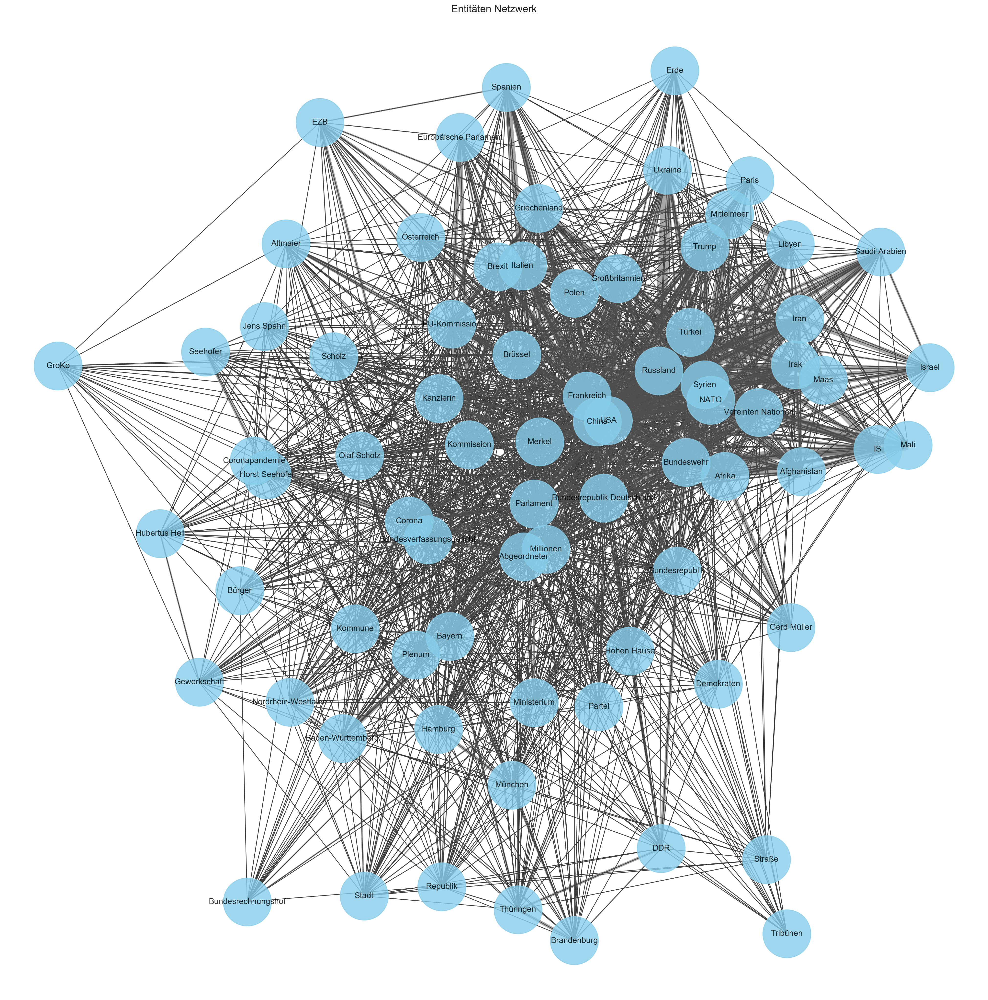

In [567]:
# identify the greatest component (connected subgraph)
# and plot only that one
giant_component = sorted(nx.connected_components(graph_entities), key=len, reverse=True)
graph_entities = graph_entities.subgraph(giant_component[0])

#pos = nx.kamada_kawai_layout(graph_entities, weight='weight')
pos = nx.fruchterman_reingold_layout(graph_entities, weight='weight')
#pos = nx.circular_layout(graph_entities)

_ = plt.figure(figsize=(20, 20))
nx.draw(graph_entities, pos, 
        node_size=5000, 
        node_color='skyblue',
        alpha=0.8,
        with_labels = True)
_ = plt.title('Entitäten Netzwerk', size=15)

for (node1,node2,data) in graph_entities.edges(data=True):
    width = data['weight'] / 10
    _ = nx.draw_networkx_edges(graph_entities,pos,
                               edgelist=[(node1, node2)],
                               width=width,
                               edge_color='#505050',
                               alpha=0.5)
    
plt.savefig("EntitiesNetwork.png", format="PNG")

Wie oben schon erwähnt, lässt sicht aus allen Entiäten kein klar lesbares Netzwerk bilden. Obwohl die fünfzehn häufigsten Entitäten schon weggelassen wurden, ist das ganze noch sehr unübersichtlich.

### Nur für Personen

Jetzt schauen wir uns mal das Netzwerk alles häufigst genannten Personen an.

In [449]:
graph_persons = nx.from_pandas_edgelist(cooc_persons_df.query('freq > 5').rename(columns={'freq': 'weight'}), 
                                    source='source', target='target', edge_attr=True)

In [450]:
# show nodes & edges
graph_persons.nodes
graph_persons.edges

NodeView(('Hubertus Heil', 'Olaf Scholz', 'Wolfgang Schäuble', 'Jens Spahn', 'Karl Lauterbach', 'Otto Fricke', 'Peter Altmaier', 'Eckhardt Rehberg', 'Gerd Müller', 'Donald Trump', 'Heiko Maas', 'Gesine Lötzsch', 'Sabine Dittmar', 'Fritz Güntzler', 'Horst Seehofer', 'Andrea Nahles', 'Maria Klein-Schmeink', 'Kordula Schulz-Asche', 'Angela Merkel', 'Helmut Kohl', 'Johannes Kahrs', 'Johannes Vogel', 'Ludwig Erhard', 'Pascal Kober', 'Peter Weiß', 'Max Straubinger', 'Hans Michelbach', 'Markus Kurth', 'Christian Lindner', 'Emmanuel Macron', 'Willy Brandt', 'Lothar Binding', 'Omid Nouripour', 'Stephan Stracke', 'Detlev Spangenberg', 'Sebastian Brehm', 'Ekin Deligöz', 'Rolf Mützenich', 'Walter Lübcke', 'Franziska Giffey', 'Helmut Schmidt', 'Agnieszka Brugger', 'Jörg Cezanne', 'Lisa Paus', 'Rudolf Henke', 'Svenja Schulze', 'Harald Weinberg', 'Bernd Rützel', 'Carl-Julius Cronenberg', 'Christine Lambrecht', 'Uwe Witt', 'Sigmar Gabriel', 'Roderich Kiesewetter', 'Matthias Zimmer', 'Annegret Kramp-Ka

EdgeView([('Hubertus Heil', 'Olaf Scholz'), ('Hubertus Heil', 'Gerd Müller'), ('Hubertus Heil', 'Jens Spahn'), ('Hubertus Heil', 'Andrea Nahles'), ('Hubertus Heil', 'Johannes Vogel'), ('Hubertus Heil', 'Pascal Kober'), ('Hubertus Heil', 'Peter Weiß'), ('Hubertus Heil', 'Peter Altmaier'), ('Hubertus Heil', 'Stephan Stracke'), ('Hubertus Heil', 'Max Straubinger'), ('Hubertus Heil', 'Uwe Witt'), ('Hubertus Heil', 'Rolf Mützenich'), ('Hubertus Heil', 'Matthias Zimmer'), ('Olaf Scholz', 'Wolfgang Schäuble'), ('Olaf Scholz', 'Otto Fricke'), ('Olaf Scholz', 'Peter Altmaier'), ('Olaf Scholz', 'Eckhardt Rehberg'), ('Olaf Scholz', 'Fritz Güntzler'), ('Olaf Scholz', 'Gesine Lötzsch'), ('Olaf Scholz', 'Horst Seehofer'), ('Olaf Scholz', 'Hans Michelbach'), ('Olaf Scholz', 'Christian Lindner'), ('Olaf Scholz', 'Lothar Binding'), ('Olaf Scholz', 'Jens Spahn'), ('Olaf Scholz', 'Sebastian Brehm'), ('Olaf Scholz', 'Rolf Mützenich'), ('Olaf Scholz', 'Gerd Müller'), ('Olaf Scholz', 'Heiko Maas'), ('Olaf S

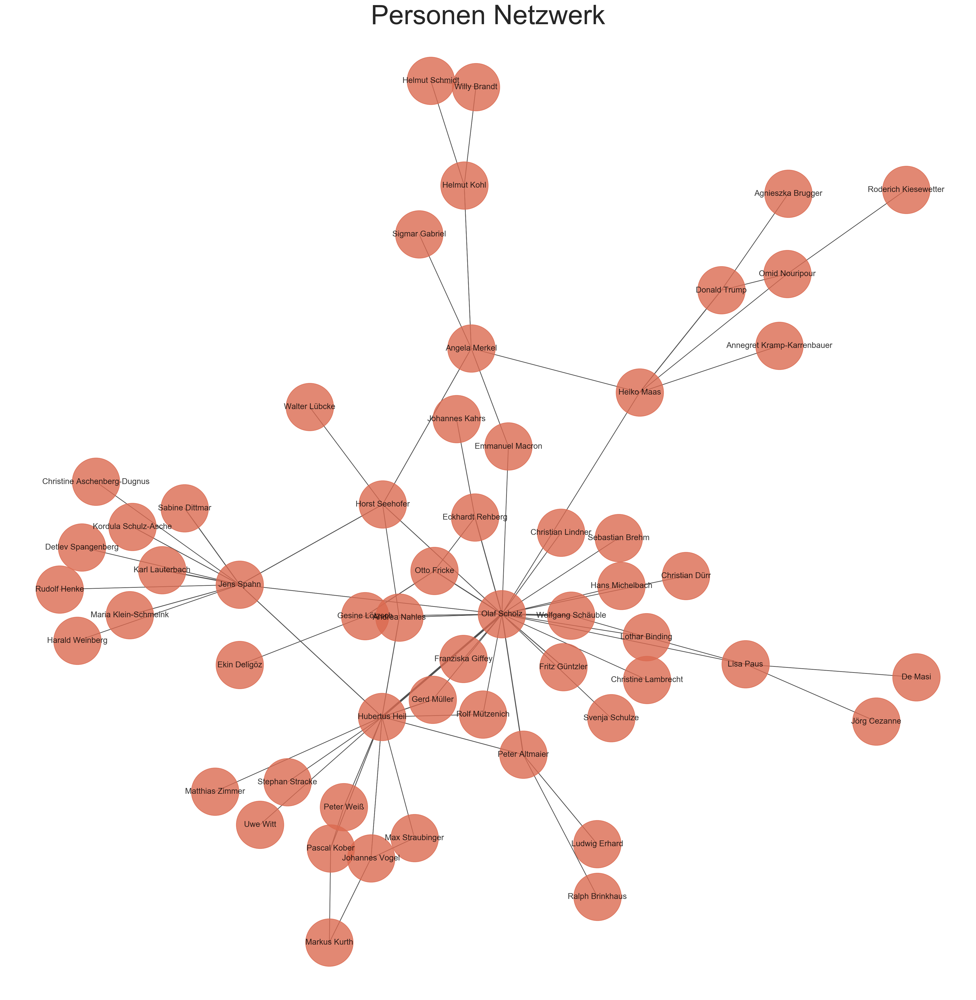

In [507]:
# identify the greatest component (connected subgraph)
# and plot only that one
giant_component = sorted(nx.connected_components(graph_persons), key=len, reverse=True)
graph_persons = graph_persons.subgraph(giant_component[0])

# pos = nx.kamada_kawai_layout(graph_persons, weight='weight')
pos = nx.fruchterman_reingold_layout(graph_persons, weight='weight')
# pos = nx.circular_layout(graph_persons)

_ = plt.figure(figsize=(20, 20))
nx.draw(graph_persons, pos, 
        node_size=5000, 
        node_color='#db6a50',
        alpha=0.8,
        with_labels = True)
_ = plt.title('Personen Netzwerk', size=40)

for (node1,node2,data) in graph_persons.edges(data=True):
    width = data['weight'] / 10
    _ = nx.draw_networkx_edges(graph_persons,pos,
                               edgelist=[(node1, node2)],
                               width=width,
                               edge_color='#505050',
                               alpha=1)
    
plt.savefig("PersonNetwork.png", format="PNG")

Das schaut schon deutlich besser aus.
Im Zentrum des Graphen steht Fizekanzler [Olaf Scholz](https://de.wikipedia.org/wiki/Olaf_Scholz).
Die weiteren hochrangigen Politiker sind mit [Linder](https://de.wikipedia.org/wiki/Christian_Lindner) (Bundesvorsitzender der FDP), [Nahles](https://de.wikipedia.org/wiki/Andrea_Nahles) (ehem. SPD Vorsitzende), [Schäuble](https://de.wikipedia.org/wiki/Wolfgang_Sch%C3%A4uble) (Bundestagspräsident) und [Giffey](https://de.wikipedia.org/wiki/Franziska_Giffey) (ehem. Familienministerin) auch sehr zentrumsnahe.

Außenpolitik (rechte obere Ecke): Hinter [Heiko Maas](https://de.wikipedia.org/wiki/Heiko_Maas) (Außenminister) versammeln sich [AKK](https://de.wikipedia.org/wiki/Annegret_Kramp-Karrenbauer) (Verteidigungsministerin), [Donald Trump](https://de.wikipedia.org/wiki/Donald_Trump), [Brugger](https://de.wikipedia.org/wiki/Agnieszka_Brugger) (Friedens- und Sicherheitspolitikerin der Grünen), [Nouripour](https://de.wikipedia.org/wiki/Omid_Nouripour) (stellv. Mitglied des Verteidigungsauschusses der Grünen) und [Kiesewetter](https://de.wikipedia.org/wiki/Roderich_Kiesewetter) (ehem. Generalstaatsoffizier der Bundeswehr).

Arbeit, Soziales & Wirtschaft (linke untere Ecke): Nach [Hubertus Heil](https://de.wikipedia.org/wiki/Hubertus_Heil) (Bundesminister für Arbeit & Soziales) folgen Arbeit- & sozialpolitische Sprecher/Leiter ([Weiß](https://de.wikipedia.org/wiki/Peter_Wei%C3%9F_(Politiker)), [Kober](https://de.wikipedia.org/wiki/Pascal_Kober), [Kurth](https://de.wikipedia.org/wiki/Markus_Kurth_(Politiker)), [Straubinger](https://de.wikipedia.org/wiki/Max_Straubinger) ), Wirtschaftler ([Witt](https://de.wikipedia.org/wiki/Uwe_Witt_(Politiker)), [Vogel](https://de.wikipedia.org/wiki/Johannes_Vogel_(Politiker)#Politische_Positionen) ) ),Juristen ([Starcke](https://de.wikipedia.org/wiki/Stephan_Stracke)) und Politikwissenschaftler([Zimmer](https://de.wikipedia.org/wiki/Matthias_Zimmer#Politik)).

Außerdem wird Bundeswirtschaftsminister [Altmaier](https://de.wikipedia.org/wiki/Peter_Altmaier) häufig mit [Hubertus Heil](https://de.wikipedia.org/wiki/Hubertus_Heil) in verbundung gebracht. Auf Altmeier folgen [Brinkhaus](https://de.wikipedia.org/wiki/Ralph_Brinkhaus) (stellv. Fraktionsvorsitzender der CDU) und der bereits verstorbene ehem. Bundeskanzler und "Vater der der Sozialen Marktwirtschaft" [Ludwig Erhard](https://de.wikipedia.org/wiki/Ludwig_Erhard).

Auf den Gesundheitsminister [Jens Spahn](https://de.wikipedia.org/wiki/Jens_Spahn) folgen auf der linken Seite vermehrt Politiker mit dem Schwerpunkt Gesundheit ([Dittmar](https://de.wikipedia.org/wiki/Sabine_Dittmar), [Lauterbach](https://de.wikipedia.org/wiki/Karl_Lauterbach), [Henke](https://de.wikipedia.org/wiki/Rudolf_Henke), [Aschenberg-Dugnus](https://de.wikipedia.org/wiki/Christine_Aschenberg-Dugnus), [Weinberg](https://de.wikipedia.org/wiki/Harald_Weinberg), [Spangenberg](https://de.wikipedia.org/wiki/Detlev_Spangenberg#Politisches_Engagement,_Mitgliedschaften_und_Positionen)), Soziolgie ([Schmeink](https://de.wikipedia.org/wiki/Maria_Klein-Schmeink)) oder der Kommunikationswissenschaft ([Schulz-Asche](https://de.wikipedia.org/wiki/Kordula_Schulz-Asche)).

Mit Bundesinnenminister [Seehofer](https://de.wikipedia.org/wiki/Horst_Seehofer) wird u.a. der ermordete Politiker [Walter Lübcke](https://de.wikipedia.org/wiki/Walter_L%C3%BCbcke) in Verbindung gebracht.

Über frankreichs Staatspräsident [Macron](https://de.wikipedia.org/wiki/Emmanuel_Macron) gelangt man zu der überraschenderweise nicht sehr zentrumsnahen [Angela Merkel](https://de.wikipedia.org/wiki/Angela_Merkel). Diese wird währenddessen mit dem ehem. Bundesvorsitzenden der SPD [Sigmar Gabriel](https://de.wikipedia.org/wiki/Sigmar_Gabriel) und den ehem. Bundeskanzlern [Kohl](https://de.wikipedia.org/wiki/Helmut_Kohl), [Schmidt](https://de.wikipedia.org/wiki/Helmut_Schmidt) und [Brandt](https://de.wikipedia.org/wiki/Willy_Brandt) in Verbindung gebracht.

### Nur für Locations

Das Netzwerk der am häufigsten genannten Locations:

In [517]:
graph_locations = nx.from_pandas_edgelist(cooc_locations_df.query('freq > 5').rename(columns={'freq': 'weight'}), 
                                    source='source', target='target', edge_attr=True)

In [518]:
# show nodes & edges
graph_locations.nodes
graph_locations.edges

NodeView(('China', 'USA', 'Russland', 'Syrien', 'Türkei', 'Frankreich', 'Irak', 'Großbritannien', 'Ukraine', 'Iran', 'Italien', 'Berlin', 'Hamburg', 'Spanien', 'Afghanistan', 'Mali', 'Brüssel', 'Libyen', 'Mittelmeer', 'Bayern', 'Israel', 'Saudi-Arabien', 'Griechenland', 'Baden-Württemberg', 'Afrika', 'München', 'Polen', 'Thüringen', 'Brandenburg', 'Österreich', 'Nordrhein-Westfalen', 'Bundesverfassungsgericht', 'Erde', 'Bundesrechnungshof'))

EdgeView([('China', 'USA'), ('China', 'Russland'), ('China', 'Frankreich'), ('China', 'Iran'), ('China', 'Türkei'), ('China', 'Großbritannien'), ('China', 'Berlin'), ('China', 'Afrika'), ('China', 'Syrien'), ('China', 'Italien'), ('China', 'Brüssel'), ('China', 'Saudi-Arabien'), ('China', 'Libyen'), ('China', 'Erde'), ('China', 'Afghanistan'), ('China', 'Ukraine'), ('China', 'Polen'), ('China', 'Irak'), ('China', 'Israel'), ('China', 'Griechenland'), ('China', 'Bayern'), ('China', 'Österreich'), ('China', 'Baden-Württemberg'), ('China', 'Spanien'), ('China', 'Mittelmeer'), ('China', 'Bundesverfassungsgericht'), ('China', 'Nordrhein-Westfalen'), ('China', 'München'), ('China', 'Mali'), ('China', 'Brandenburg'), ('China', 'Hamburg'), ('China', 'Thüringen'), ('USA', 'Russland'), ('USA', 'Frankreich'), ('USA', 'Syrien'), ('USA', 'Iran'), ('USA', 'Türkei'), ('USA', 'Großbritannien'), ('USA', 'Berlin'), ('USA', 'Afghanistan'), ('USA', 'Saudi-Arabien'), ('USA', 'Italien'), ('USA', 'Irak'), ('

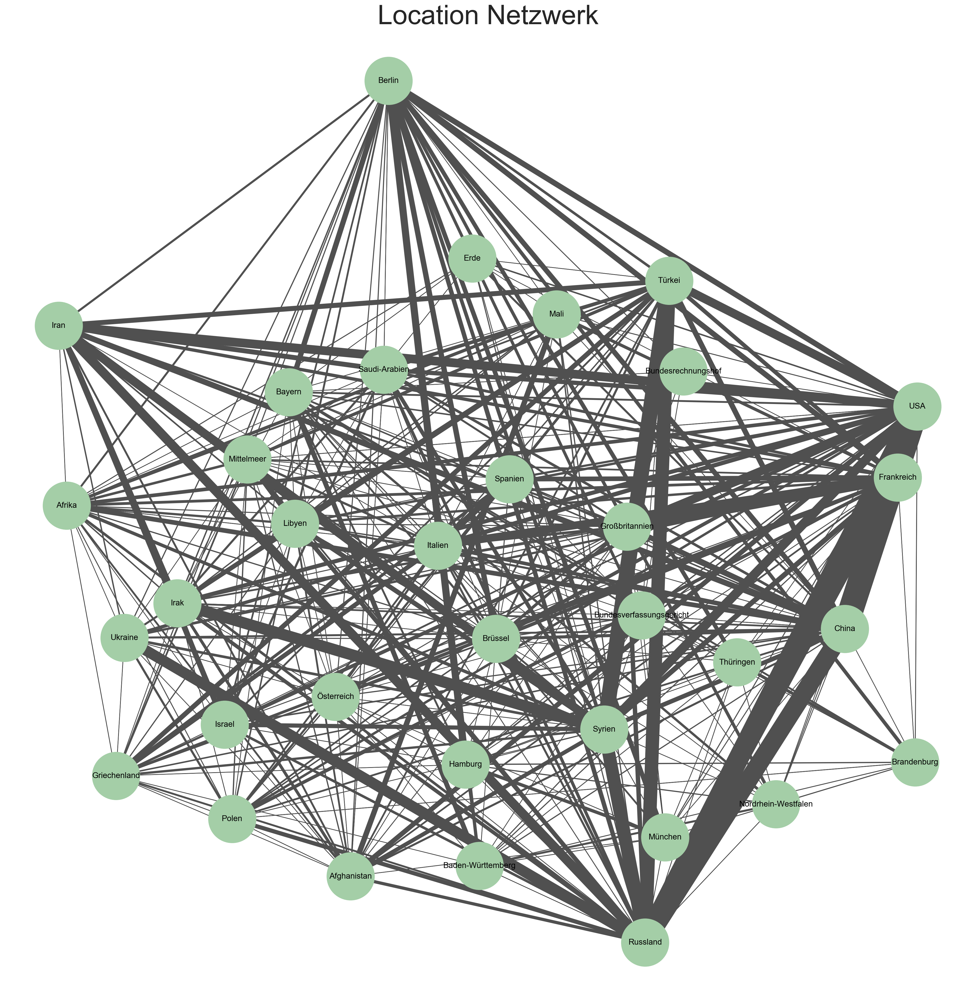

In [520]:
# identify the greatest component (connected subgraph)
# and plot only that one
giant_component = sorted(nx.connected_components(graph_locations), key=len, reverse=True)
graph_locations = graph_locations.subgraph(giant_component[0])

pos = nx.kamada_kawai_layout(graph_locations, weight='weight')
#pos = nx.fruchterman_reingold_layout(graph_locations, weight='weight')
#pos = nx.circular_layout(graph_locations)

_ = plt.figure(figsize=(20, 20))
nx.draw(graph_locations, pos, 
        node_size=5000, 
        node_color='#a4cea7',
        alpha=1,
        with_labels = True)
_ = plt.title('Location Netzwerk', size=40)

for (node1,node2,data) in graph_locations.edges(data=True):
    width = data['weight'] / 10
    _ = nx.draw_networkx_edges(graph_locations,pos,
                               edgelist=[(node1, node2)],
                               width=width,
                               edge_color='#505050',
                               alpha=1)
    
plt.savefig("LocationNetwork.png", format="PNG")

Die Eckpfeiler dieser Grafik sind Russland, China, Frankreich, USA, Iran, Berlin und die Türkei (Dabei gilt zu beachten das Deutschland und Europa aus übersichtlichkeits Gründen weggelassen wurde). 

Vor allem die Mächte USA, China, Frankreich & Russland werden häufig in den selben Reden erwähnt. Auch Syrien, die Ukraine, der Iran und die Türkei werden mit Russland häufig in Verbindung gebracht.

Im Zentrum des Netzwerks stehen neben der Europäischen Hauptstadt Brüssel, die Ländern Italien, Spanien und Großbritiannien, sowie das Bundesverfssungsgericht und der Bundesrechnungshof. Deutlich wird dabei aber das vor allem Brüssel in Verbindung mit den Großmächten keine besondere Rolle spielt.

Die Bereiche mit Iran, Irak, Mali, Afrika, Saudi-Arabien, Libyen, Italien und Mittelmeer lassen sich auf die Flüchtlingskrise zurückführen.

Die deutschen Bundesländern Bayern, Baden-Württemberg, Berlin, Hamburg, Nordrhein-Westfalen, Brandenburg und Thüringen scheinen ein größere Rolle zu spielen. Thürungen und Brandenburg, die beide keine besondere Wirtschaftskraft sind und auch sonst kein erhöhtes politisches Intresse hervorrufen sind doch eher überraschend in der Grafik verteten. Bei Thüringen könnte das unseren Vermutungen nach an der viel diskutierten [Regierungskrise um Thomas Kemmerich](https://de.wikipedia.org/wiki/Regierungskrise_in_Th%C3%BCringen_2020) liegen, bei Brandenburg hingegen könnte es an der geplanten [Tesla Fabrik von Elon Musk](https://de.wikipedia.org/wiki/Tesla_Gigafactory_Berlin-Brandenburg) liegen, die ebenfalls für Diskussionen sorgte.

### Nur für Organisationen

Das Netzwerk der am häufigsten genannten Organisationen:

In [568]:
graph_organisations = nx.from_pandas_edgelist(cooc_organisations_df.query('freq > 5').rename(columns={'freq': 'weight'}), 
                                    source='source', target='target', edge_attr=True)

In [569]:
# show nodes & edges
graph_organisations.nodes
graph_organisations.edges

NodeView(('Bundeswehr', 'NATO', 'Vereinten Nationen', 'Parlament', 'IS', 'Verteidigungsministerium', 'Taliban', 'Ministerium', 'MINUSMA', 'EU-Kommission', 'Europäische Parlament', 'EU-Mitgliedstaaten', 'Plenum', 'Sea Guardian', 'DDR', 'SED', 'UN-Sicherheitsrat', 'UN', 'ESM', 'EZB', 'OSZE', 'Bundespolizei', 'BMZ', 'Kommune', 'BAMF', 'UNO', 'Europarat', 'WHO', 'Europäischen Rat', 'EU-Ratspräsidentschaft', 'Hisbollah', 'IWF', 'Enquete-Kommission', 'UNHCR', 'EuGH', 'Gewerkschaft', 'THW', 'Frontex', 'DGB', 'OECD', 'BMI', 'KfW', 'RKI', 'Innenministerium', 'GroKo', 'Corona', 'Europa', 'Justizministerium', 'VW', 'Wirtschaftsministerium', 'Kita', 'BaFin'))

EdgeView([('Bundeswehr', 'NATO'), ('Bundeswehr', 'Vereinten Nationen'), ('Bundeswehr', 'Parlament'), ('Bundeswehr', 'IS'), ('Bundeswehr', 'Verteidigungsministerium'), ('Bundeswehr', 'Taliban'), ('Bundeswehr', 'Ministerium'), ('Bundeswehr', 'MINUSMA'), ('Bundeswehr', 'Sea Guardian'), ('Bundeswehr', 'UN-Sicherheitsrat'), ('Bundeswehr', 'UN'), ('Bundeswehr', 'Bundespolizei'), ('Bundeswehr', 'Plenum'), ('Bundeswehr', 'UNO'), ('Bundeswehr', 'Hisbollah'), ('Bundeswehr', 'THW'), ('Bundeswehr', 'BMZ'), ('Bundeswehr', 'Frontex'), ('Bundeswehr', 'EU-Kommission'), ('Bundeswehr', 'Kommune'), ('Bundeswehr', 'OSZE'), ('Bundeswehr', 'BAMF'), ('Bundeswehr', 'Europäischen Rat'), ('Bundeswehr', 'Europäische Parlament'), ('Bundeswehr', 'Europa'), ('NATO', 'Vereinten Nationen'), ('NATO', 'IS'), ('NATO', 'Sea Guardian'), ('NATO', 'Parlament'), ('NATO', 'Taliban'), ('NATO', 'OSZE'), ('NATO', 'Verteidigungsministerium'), ('NATO', 'EU-Kommission'), ('NATO', 'UNO'), ('NATO', 'UN'), ('NATO', 'Ministerium'), ('N

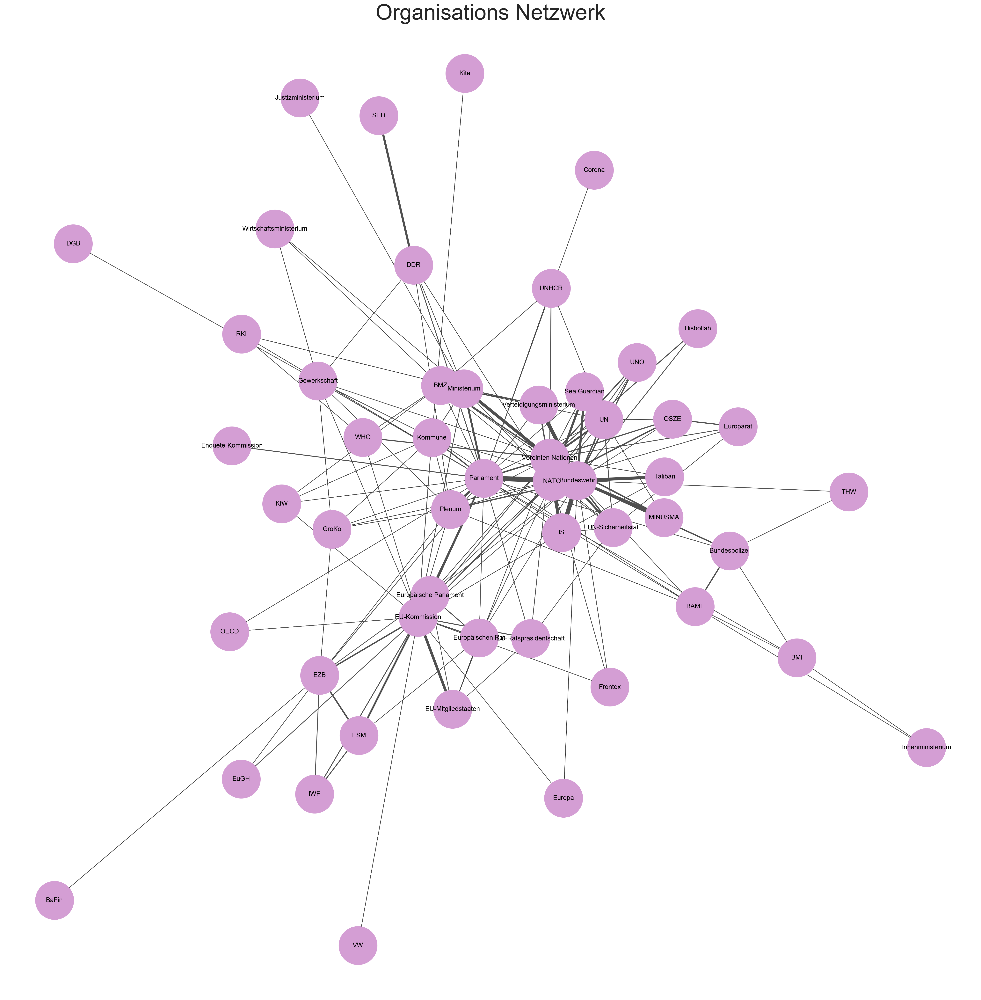

In [570]:
# identify the greatest component (connected subgraph)
# and plot only that one
giant_component = sorted(nx.connected_components(graph_organisations), key=len, reverse=True)
graph_organisations = graph_organisations.subgraph(giant_component[0])

#pos = nx.kamada_kawai_layout(graph_organisations, weight='weight')
pos = nx.fruchterman_reingold_layout(graph_organisations, weight='weight')
# pos = nx.circular_layout(graph_organisations)

_ = plt.figure(figsize=(25, 25))
nx.draw(graph_organisations, pos, 
        node_size=5000, 
        node_color='#d49ed4',
        alpha=1,
        with_labels = True)
_ = plt.title('Organisations Netzwerk', size=40)

for (node1,node2,data) in graph_organisations.edges(data=True):
    width = data['weight'] / 10
    _ = nx.draw_networkx_edges(graph_organisations,pos,
                               edgelist=[(node1, node2)],
                               width=width,
                               edge_color='#505050',
                               alpha=1)
    
plt.savefig("OrganisationNetwork.png", format="PNG")

Bubble1 EU: Rund ums Europäische Parlament, reihen sich sämtliche europäische Organisationen ein u.a. die EU-Kommission, der Europäische Rat und die EU-Ratspräsidentschaft. 
Daneben befinden sich dar EuGH, ESM, EZB, OECD aber auch VW das wegen des [Abgasskandals](https://ec.europa.eu/germany/news/20180717-vw-abgasskandal-aktionsplan-umgesetzt_de) häufig mit der EU-Kommission in Verbindung gebracht wurde.

Bubble 2 NATO/Bundeswehr: Im Bereich um die NATO befinden sich alle außenpolitischen Organisationen z.B. UN, der [OSZE](https://de.wikipedia.org/wiki/Organisation_f%C3%BCr_Sicherheit_und_Zusammenarbeit_in_Europa), der UN-Sicherheitsrat, dai [MINUSMA](https://de.wikipedia.org/wiki/United_Nations_Multidimensional_Integrated_Stabilization_Mission_in_Mali), die UNO aber auch Terrororganisationen wie die Taliban, der IS und die Hisbollah.

Bubble 3 Parlament: Über das Parlament, den Ministerien und den Kommunen gelangt man zu den Gewerkschaften, der WHO, der [Enquete-Kommission](https://de.wikipedia.org/wiki/Enquete-Kommission), dem RKI und der DDR.
